In [156]:
import os
import numpy as np
import librosa 

import torch
import dataset
import easydict
import argparse
import network
import utils
import torchaudio

from torch.utils.data import DataLoader

import matplotlib.pyplot as plt
import IPython.display as ipd

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"] = "3"

In [157]:
def play_audio(waveform, sample_rate):
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  if num_channels == 1:
    display(Audio(waveform[0], rate=sample_rate))
  elif num_channels == 2:
    display(Audio((waveform[0], waveform[1]), rate=sample_rate))
  else:
    raise ValueError("Waveform with more than 2 channels are not supported.")

def plot_complex_spectrogram(spec, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.amplitude_to_db(spec), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)

def plot_spectrogram(spec, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)
    
def plot_db_spectrogram(spec, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(spec, origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)

In [162]:
opt = easydict.EasyDict({
    "data_dir": '/data1/singing_inpainting/dataset',
    "input_length": 220500,
    "image_height": 1025,
    "image_width": 431,
    "bbox_shape": 120,
    "num_workers": 4,
    "batch_size": 8,
    "mask_type" : 'time',
    "load_name" : '/data2/personal/jaejun/inpainting/results/210719/time3/models/deepfillv2_WGAN_epoch115_batchsize4.pth',
    "sample_path" : '/data2/personal/jaejun/inpainting/results/210719/time3/validation26',
    "in_channels" : 2,
    "out_channels" : 1,
    "latent_channels" : 32,
    "pad_type": 'zero',
    "activation": 'lrelu',
    "norm": 'in',
    })

In [173]:
testset = dataset.InpaintDataset(opt, split='TRAIN')
print('The overall number of images equals to %d' % len(testset))
dataloader = DataLoader(testset, batch_size = opt.batch_size, pin_memory = True)


The overall number of images equals to 6605


In [174]:
a = testset[0]
audio = a[0]
img = a[1]
mask = a[2]
audio.shape, img.shape, mask.shape

(torch.Size([1, 220500]),
 torch.Size([1, 1025, 431]),
 torch.Size([1, 1025, 431]))

In [175]:
for i, (audio, img, mask) in enumerate(dataloader):
    stop

NameError: name 'stop' is not defined

In [176]:
img.shape, mask.shape

(torch.Size([8, 1, 1025, 431]), torch.Size([8, 1, 1025, 431]))

In [184]:
img_pad = torch.nn.functional.pad(img, (1, 1, 0, 0), mode='constant', value=0)
mask_pad = torch.nn.functional.pad(mask, (1, 1, 0, 0), mode='constant', value=0)
mask_range = torch.where(mask_pad[:,0,0,:]==1)
start = torch.min(mask_range[0])-1
end = torch.max(mask_range[0])-1

In [185]:
img_pad.shape, mask_pad.shape

(torch.Size([8, 1, 1025, 433]), torch.Size([8, 1, 1025, 433]))

In [201]:
a, b = torch.where(mask_pad[:,0,0,]==1)
a.shape, b.shape
torch.where(a==b)

(torch.Size([266]), torch.Size([266]))

In [255]:
lerp_idxs = torch.zeros([opt.batch_size, 2])
for i2 in range(opt.batch_size):
    start = torch.min(torch.where(a==i2)[0])
    end = torch.max(torch.where(a==i2)[0])
    lerp_idxs[i2][0] = start
    lerp_idxs[i2][1] = end + 2
    merged = torch.cat([img_pad[i2,0,:,start].unsqueeze(-1), img_pad[i2,0,:,end].unsqueeze(-1)], -1).unsqueeze(0)
    interpolated_mask = torch.nn.functional.interpolate(merged, size=end-start, mode='linear')
#     plt.imshow(interpolated_mask[0])
#     plt.show()
#     print(end-start, interpolated_mask.shape)
    print(interpolated_mask.shape)

torch.Size([1, 1025, 28])
torch.Size([1, 1025, 71])
torch.Size([1, 1025, 24])
torch.Size([1, 1025, 67])
torch.Size([1, 1025, 36])
torch.Size([1, 1025, 15])
torch.Size([1, 1025, 9])
torch.Size([1, 1025, 8])


In [254]:
merged = torch.cat([img_pad[:,0,:,start].unsqueeze(-1), img_pad[:,0,:,end].unsqueeze(-1)], -1)

In [247]:
merged.shape

torch.Size([1025, 2])

In [ ]:
a = torch.tensor([[[1.0, 3.0, 5.0, 7.0, 9.0]]])
b = torch.nn.functional.interpolate(a, size=10, mode='linear')
b.shape

In [235]:
interpolated.shape

torch.Size([8, 1025, 100])

In [238]:
merged.shape

torch.Size([1, 1025, 2])

In [214]:
a, b

(tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5,
         5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7,
         7, 7]),
 tensor([ 49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,
          63,

In [200]:
np_mask_pad = np.asarray(mask_pad)
np.where(np_mask_pad)

(array([0, 0, 0, ..., 7, 7, 7]),
 array([0, 0, 0, ..., 0, 0, 0]),
 array([   0,    0,    0, ..., 1024, 1024, 1024]),
 array([ 49,  50,  51, ..., 126, 127, 128]))

In [27]:
lerp = torch.lerp(img[0][:,10], img[0][:,20], 10)

In [89]:
start = img[:][:,10]
end = img[0][:,100]
lerp = end - start

In [90]:
a = torch.tensor([[[1.0, 3.0, 5.0, 7.0, 9.0]]])
b = torch.nn.functional.interpolate(a, size=10, mode='linear')
b.shape

torch.Size([1, 1, 10])

In [91]:
merge = torch.cat([start.unsqueeze(-1), end.unsqueeze(-1)], dim=1).unsqueeze(0)
print(merge.shape)
b = torch.nn.functional.interpolate(merge, size=10, mode='linear')
b.shape

torch.Size([1, 1025, 2])


torch.Size([1, 1025, 10])

In [92]:
start[0], end[0]

(tensor(-9.3103), tensor(-18.7372))

In [99]:
b[0][0]

tensor([ -9.3103,  -9.3103,  -9.3103, -11.1957, -13.0811, -14.9664, -16.8518,
        -18.7372, -18.7372, -18.7372])

In [101]:
img.shape

torch.Size([1, 1025, 431])

In [151]:
img_pad = torch.nn.functional.pad(img, (1, 1, 0, 0), mode='constant', value=0).unsqueeze(0)
mask_pad = torch.nn.functional.pad(mask, (1, 1, 0, 0), mode='constant', value=0).unsqueeze(0)
mask_range = torch.where(mask_pad[0][0]==1)
start = torch.min(mask_range[0])-1
end = torch.max(mask_range[0])-1

In [152]:
merge = torch.cat([img_pad[start].unsqueeze(-1), img_pad[:,end].unsqueeze(-1)], dim=-1).unsqueeze(0)
print(merge.shape)
b = torch.nn.functional.interpolate(merge, size=10, mode='linear')
b.shape

IndexError: index 8 is out of bounds for dimension 0 with size 1

img_pad[start].shape

In [155]:
img_pad.shape

torch.Size([1, 1, 1025, 433])

In [150]:
mask_pad.shape

torch.Size([1, 1025, 433])

In [100]:
ones = torch.ones([1, 100]) * 100
pow_to_db = torchaudio.transforms.AmplitudeToDB()
ones_db = pow_to_db(ones)

In [20]:
librosa.db_to_amplitude(ones_db)**2

tensor([[100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100., 100.,
         100., 100., 100., 100.]])

In [123]:
a = next(iter(dataloader))

In [128]:
audio = a[0]
img = a[1]
mask = a[2]
audio.shape, img.shape, mask.shape

(torch.Size([1, 1, 220500]),
 torch.Size([1, 1, 1025, 431]),
 torch.Size([1, 1, 513, 431]))

In [131]:
mask.shape

torch.Size([1, 1, 513, 431])

In [133]:
torch.sum(mask == 255)

tensor(0)

NameError: name 'first_out' is not defined

In [42]:
ipd.Audio(gf_a, rate=44100)

In [50]:
audio = testset[0][0]
log_spec = testset[0][1]

In [44]:
ipd.Audio(testset[0][0], rate=44100)

In [173]:
ref = 1.0
spec = librosa.db_to_amplitude(log_spec)**2
spec2 = 10.0**(0.5 * (log_spec + torch.log10(torch.tensor(ref))/10))
spec3 = 10.0**(log_spec/10 + torch.log10(torch.tensor(ref)))

In [178]:
audio.i

<function __main__.gflim(normalized_lin)>

In [175]:
spec, spec3

(tensor([[[8.4151e-03, 5.0064e-03, 2.1940e-02,  ..., 3.6307e-04,
           5.6206e-01, 7.9293e+01],
          [9.7394e-02, 7.8169e-02, 7.3023e-03,  ..., 1.5374e-02,
           5.9449e-01, 8.0634e+01],
          [3.8717e-01, 1.3845e-01, 4.0514e-03,  ..., 4.6271e-03,
           5.8865e-01, 8.4678e+01],
          ...,
          [3.1847e-08, 6.1009e-08, 4.9451e-07,  ..., 2.1353e-06,
           3.0777e-06, 1.2340e-05],
          [6.0796e-07, 8.2004e-07, 4.7736e-07,  ..., 1.0740e-06,
           3.2288e-07, 1.6629e-05],
          [2.1298e-06, 1.0106e-06, 5.1908e-09,  ..., 1.2990e-06,
           7.3260e-09, 1.4461e-05]]]),
 tensor([[[8.4151e-03, 5.0064e-03, 2.1940e-02,  ..., 3.6307e-04,
           5.6206e-01, 7.9293e+01],
          [9.7394e-02, 7.8169e-02, 7.3023e-03,  ..., 1.5374e-02,
           5.9449e-01, 8.0634e+01],
          [3.8717e-01, 1.3845e-01, 4.0514e-03,  ..., 4.6271e-03,
           5.8865e-01, 8.4678e+01],
          ...,
          [3.1847e-08, 6.1009e-08, 4.9451e-07,  ..., 2.135

In [145]:
spec_torch = 10.0**(0.5 * (log_spec+torch.log10(torch.tensor(1.0))/10))

In [148]:
def energy_difference(x, y):
  return 10 * torch.log10(torch.sum((x - y) ** 2) / torch.sum(x ** 2)).item()

In [150]:
energy_difference(spec, spec_torch)

inf

In [152]:
y = 10*log10(x/1)

tensor(7258563.)

In [180]:
audio.shape, test_a.shape

(torch.Size([1, 1, 220500]), torch.Size([1, 1, 1025, 431]))

In [181]:
re_gflim = torch_gflim(test_a)

In [183]:
ipd.Audio(audio[0][0], rate=44100)

In [185]:
ipd.Audio(re_gflim[0][0], rate=44100)

In [193]:
zeros = torch.zeros([1, 220500])
zeros[0][:110250] = audio[0][0][:110250]
zeros[0][110250:220160] = re_gflim[0][0][110250:220160]

In [194]:
def griffinlim(
        specgram: Tensor,
        window: Tensor,
        n_fft: int,
        hop_length: int,
        win_length: int,
        power: float,
        n_iter: int,
        momentum: float,
        length: Optional[int],
        rand_init: bool
) -> Tensor:
    r"""Compute waveform from a linear scale magnitude spectrogram using the Griffin-Lim transformation.

    Implementation ported from
    :footcite:`brian_mcfee-proc-scipy-2015`, :footcite:`6701851` and :footcite:`1172092`.

    Args:
        specgram (Tensor): A magnitude-only STFT spectrogram of dimension (..., freq, frames)
            where freq is ``n_fft // 2 + 1``.
        window (Tensor): Window tensor that is applied/multiplied to each frame/window
        n_fft (int): Size of FFT, creates ``n_fft // 2 + 1`` bins
        hop_length (int): Length of hop between STFT windows. (
            Default: ``win_length // 2``)
        win_length (int): Window size. (Default: ``n_fft``)
        power (float): Exponent for the magnitude spectrogram,
            (must be > 0) e.g., 1 for energy, 2 for power, etc.
        n_iter (int): Number of iteration for phase recovery process.
        momentum (float): The momentum parameter for fast Griffin-Lim.
            Setting this to 0 recovers the original Griffin-Lim method.
            Values near 1 can lead to faster convergence, but above 1 may not converge.
        length (int or None): Array length of the expected output.
        rand_init (bool): Initializes phase randomly if True, to zero otherwise.

    Returns:
        torch.Tensor: waveform of (..., time), where time equals the ``length`` parameter if given.
    """
    assert momentum < 1, 'momentum={} > 1 can be unstable'.format(momentum)
    assert momentum >= 0, 'momentum={} < 0'.format(momentum)

    # pack batch
    shape = specgram.size()
    specgram = specgram.reshape([-1] + list(shape[-2:]))

    specgram = specgram.pow(1 / power)

    # initialize the phase
    if rand_init:
        angles = torch.rand(
            specgram.size(),
            dtype=_get_complex_dtype(specgram.dtype), device=specgram.device)
    else:
        angles = torch.full(
            specgram.size(), 1,
            dtype=_get_complex_dtype(specgram.dtype), device=specgram.device)

    # And initialize the previous iterate to 0
    tprev = torch.tensor(0., dtype=specgram.dtype, device=specgram.device)
    for _ in range(n_iter):
        # Invert with our current estimate of the phases
        inverse = torch.istft(specgram * angles,
                              n_fft=n_fft,
                              hop_length=hop_length,
                              win_length=win_length,
                              window=window,
                              length=length)

        # Rebuild the spectrogram
        rebuilt = torch.stft(
            input=inverse,
            n_fft=n_fft,
            hop_length=hop_length,
            win_length=win_length,
            window=window,
            center=True,
            pad_mode='reflect',
            normalized=False,
            onesided=True,
            return_complex=True,
        )

        # Update our phase estimates
        angles = rebuilt
        if momentum:
            angles = angles - tprev.mul_(momentum / (1 + momentum))
        angles = angles.div(angles.abs().add(1e-16))

        # Store the previous iterate
        tprev = rebuilt

    # Return the final phase estimates
    waveform = torch.istft(specgram * angles,
                           n_fft=n_fft,
                           hop_length=hop_length,
                           win_length=win_length,
                           window=window,
                           length=length)

    # unpack batch
    waveform = waveform.reshape(shape[:-2] + waveform.shape[-1:])

    return waveform

In [179]:
test_a = spectrogram(audio)
db_test_a = pow_to_db(test_a)
re_test_a = librosa.db_to_amplitude(db_test_a)**2

In [196]:
torch.full(torch.tensor([1, 10]))

TypeError: full() received an invalid combination of arguments - got (Tensor), but expected one of:
 * (tuple of ints size, Number fill_value, *, Tensor out, torch.dtype dtype, torch.layout layout, torch.device device, bool pin_memory, bool requires_grad)
 * (tuple of ints size, Number fill_value, *, tuple of names names, torch.dtype dtype, torch.layout layout, torch.device device, bool pin_memory, bool requires_grad)


In [98]:
ipd.Audio(audio, rate=44100)

In [101]:
ipd.Audio(test_gf_a, rate=44100)

In [102]:
ipd.Audio(db_test_gf_a, rate=44100)

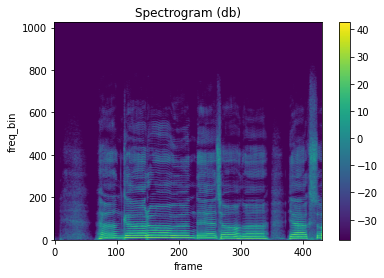

In [82]:
plot_spectrogram(test_a[0])

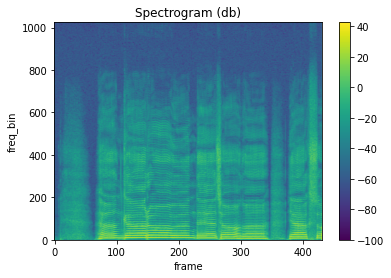

In [85]:
plot_db_spectrogram(db_test_a[0])

In [136]:
model

NameError: name 'model' is not defined

In [137]:
model = network.GatedGenerator(opt)
if opt.load_name:
    model.load_state_dict(torch.load(opt.load_name))
#     model.cuda()
# model = torch.load(opt.load_name)


FileNotFoundError: [Errno 2] No such file or directory: '/data2/personal/jaejun/inpainting/results/210719/time3/models/deepfillv2_WGAN_epoch115_batchsize4.pth'

In [52]:
torch_gflim = torchaudio.transforms.GriffinLim(n_fft=2048, n_iter=60, win_length=2048, hop_length=512)
relu = torch.nn.ReLU()

In [96]:
def gflim(normalized_lin):
    win = 2048
    def mag(S):
        real = S[...,:1]
        imag = S[...,1:]
        m = real**2 + imag**2
        m = torch.sqrt(m+1e-5)
        return m
#     l_mag = (10**normalized_lin)
    l_mag = normalized_lin
    l_mag = l_mag.unsqueeze(-1)
    l_phase = 2 * np.pi * torch.rand_like(l_mag) - np.pi
    real = l_mag * torch.cos(l_phase)
    imag = l_mag * torch.sin(l_phase)
    S = torch.cat((real, imag), axis=-1)
    S_mag = mag(S)
    for i in range(60):
        x = torch.istft(S, n_fft=win, hop_length=512, win_length=win, window=torch.hann_window(win))
        S_new = torch.stft(x, n_fft=win, hop_length=512, win_length=win, window=torch.hann_window(win))
        S_new_phase = S_new/mag(S_new)
        S = S_mag * S_new_phase
    return x

def mag(S):
    real = S[...,:1]
    imag = S[...,1:]
    m = real**2 + imag**2
    m = torch.sqrt(m+1e-5)
    return m

In [82]:
# audio_mag = mag(torch.stft(audio[0], n_fft=1024, hop_length=512, win_length=1024, window=torch.hann_window(1024)))
# audio_mag = mag(torch.stft(audio[0], n_fft=2048, hop_length=512, win_length=2048, window=torch.hann_window(2048)))
# audio_mag = audio_mag.log10()

/home/jjlee0721/inpainting/code/utils.py:144: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(2, 4)


NameError: name 'stop' is not defined

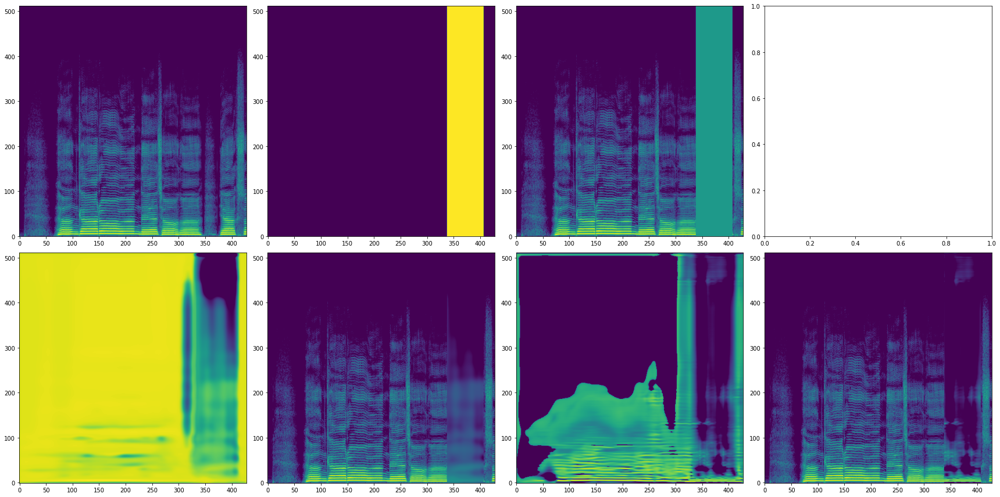

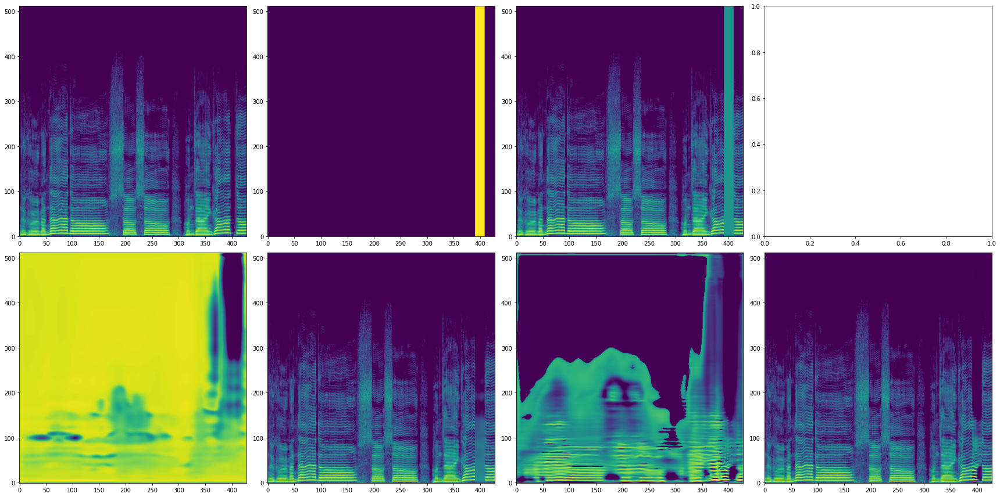

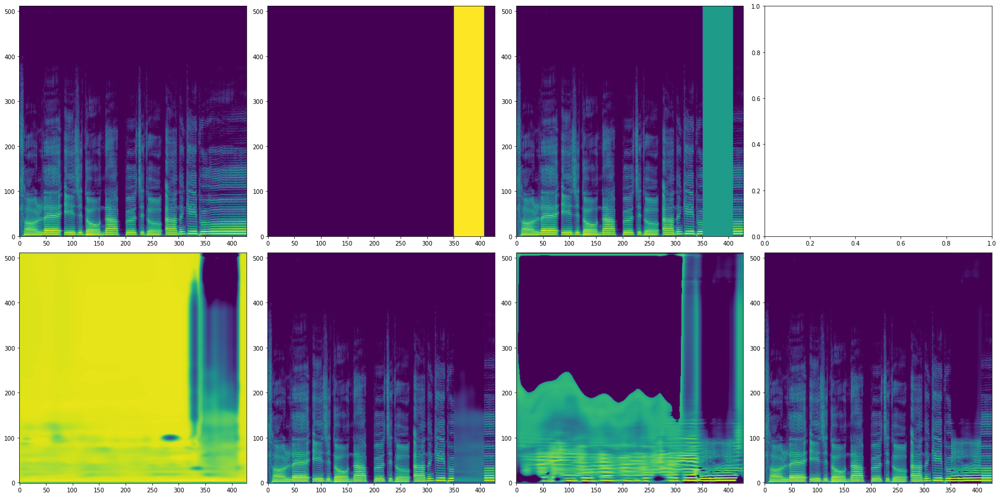

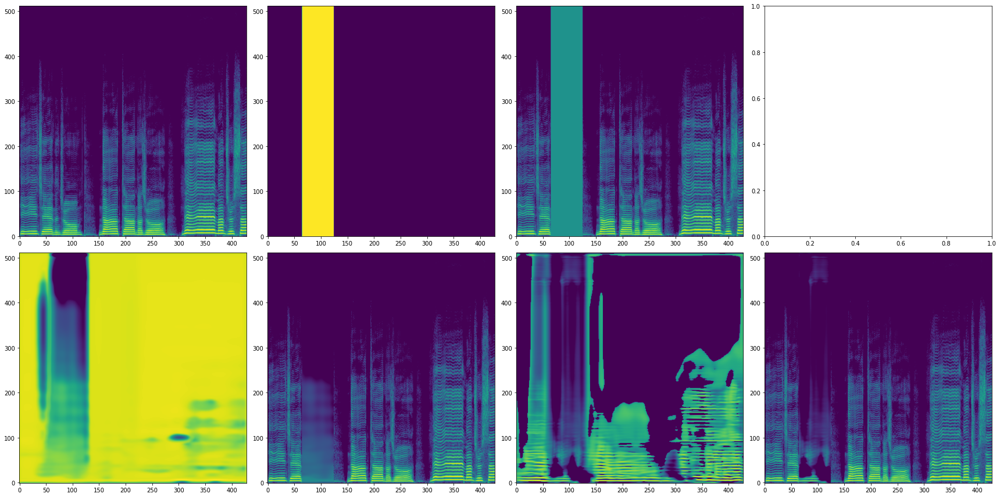

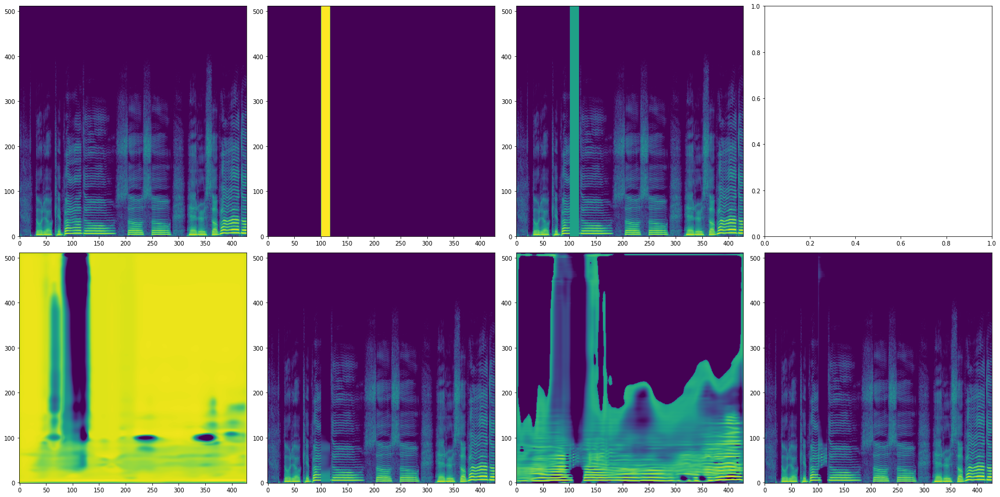

...

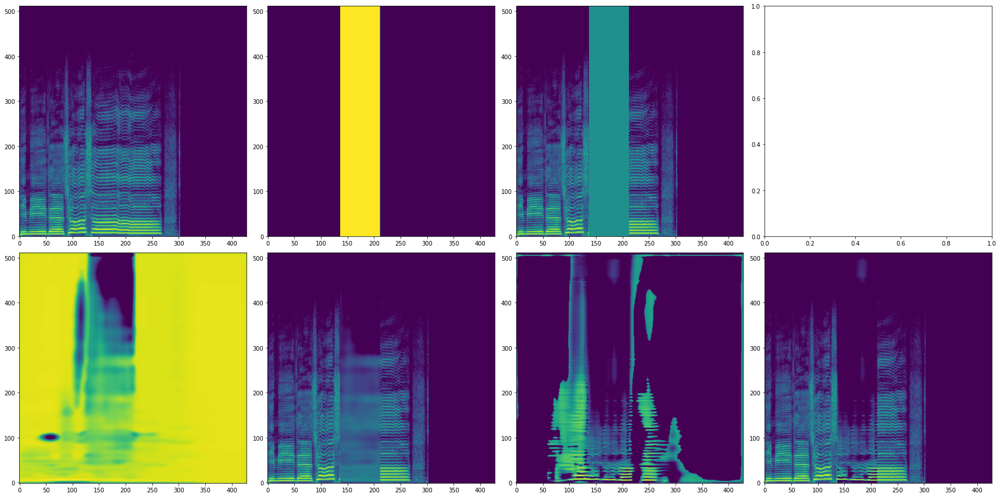

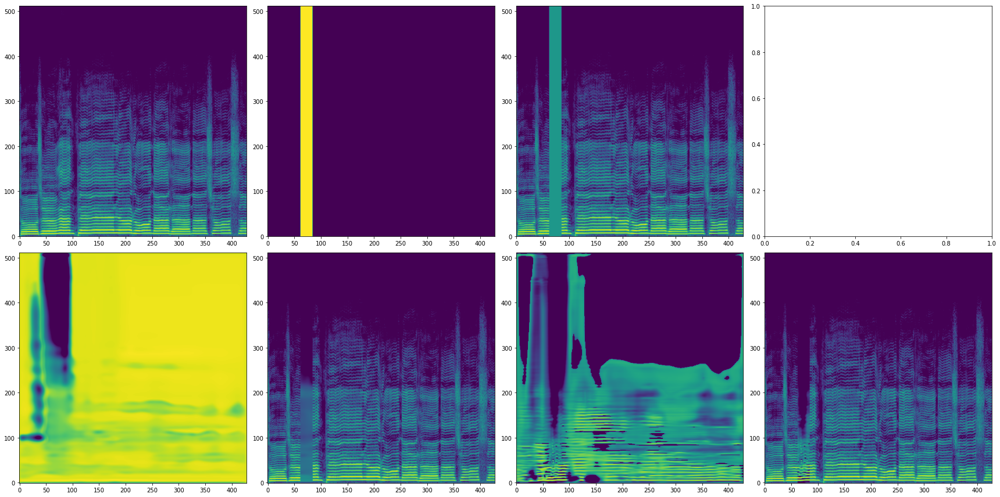

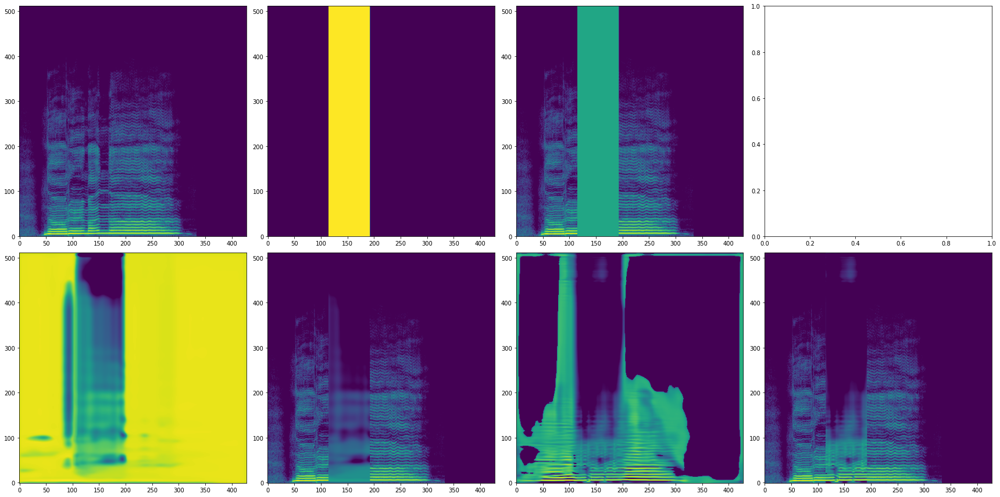

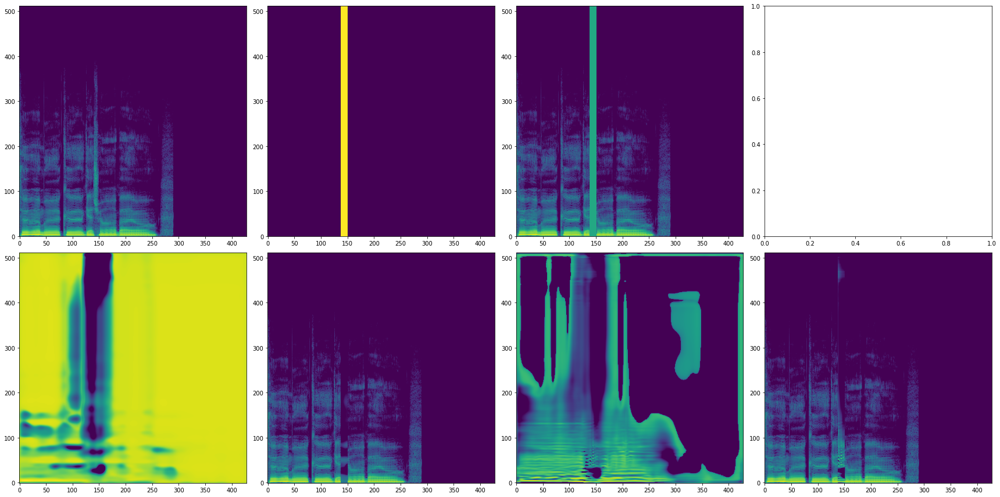

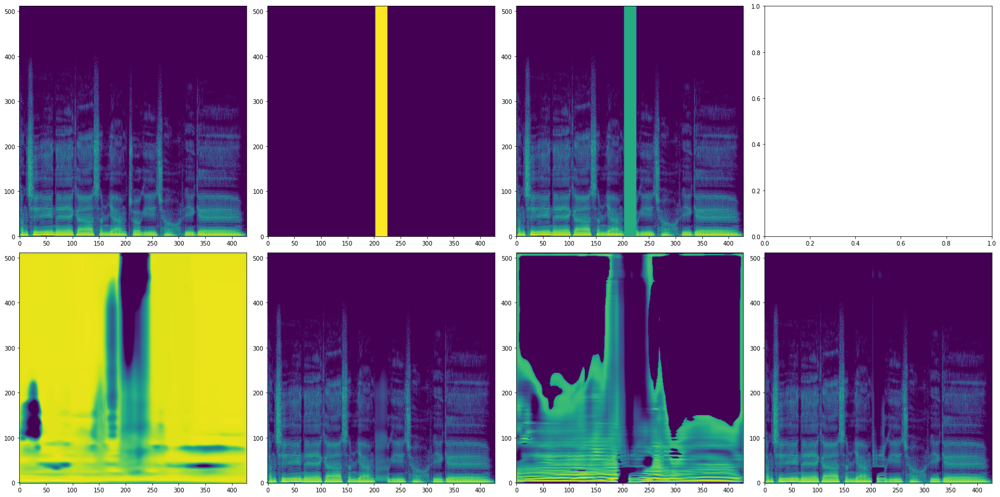

In [7]:
for batch_idx, (audio, img, mask) in enumerate(dataloader):
    if batch_idx > 50:
        stop
    sample_folder = opt.sample_path
    scaler = 1
    img = img / scaler
    img = img[:,:,:512,:428]

    img = img.cuda()
    mask = mask[:,:,:512,:428]
    mask = mask.cuda()    

    first_out, second_out = model(img, mask)
    first_out_wholeimg = img * (1 - mask) + first_out * mask        # in range [0, 1]
    second_out_wholeimg = img * (1 - mask) + second_out * mask  
    
    gt = img[0,0,:,:] * scaler
    mask = mask[0,0,:,:]
    masked_gt = gt * (1 - mask) + mask
    masked_gt = masked_gt * scaler
    first = first_out[0,0,:,:] * scaler
    firsted_img = gt * (1 - mask) + first * mask
    second = second_out[0,0,:,:] * scaler
    seconded_img = gt * (1 - mask) + second * mask    

    img_list = [gt, mask, masked_gt, first, firsted_img, second, seconded_img]

    gt = gt.detach().cpu()
    masked_gt = gt * (1 - mask.detach().cpu())
    second = second.detach().cpu()
    seconded_img = seconded_img.detach().cpu()
    
    gt_pad = torch.nn.functional.pad(gt, (0, 3, 0, 1), mode='constant', value=0)
    masked_gt_pad = torch.nn.functional.pad(masked_gt.detach().cpu(), (0, 3, 0, 1), mode='constant', value=0)
    second_pad = torch.nn.functional.pad(second, (0, 3, 0, 1), mode='constant', value=0)
    seconded_img_pad = torch.nn.functional.pad(seconded_img, (0, 3, 0, 1), mode='constant', value=0)
    
    gfl_gt_pad = gflim(gt_pad)
    gfl_masked_gt_pad = gflim(relu(masked_gt_pad))
    gfl_second_pad = gflim(relu(second_pad))
    gfl_second_img_pad = gflim(relu(seconded_img_pad))
    
    utils.save_samples(sample_folder = sample_folder, sample_name = str(batch_idx), img_list = img_list, scaler = scaler)
    
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt.wav'), audio[0], sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt_gflim.wav'), gfl_gt_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_gt_masked_gflim.wav'), gfl_masked_gt_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_pred_gfli.wav'), gfl_second_pad.unsqueeze(0), sample_rate=44100)
    torchaudio.save(os.path.join(sample_folder, str(batch_idx) + '_pred_gflim.wav'), gfl_second_img_pad.unsqueeze(0), sample_rate=44100)



In [38]:
test = seconded_img * mask.detach().cpu()
test = torch.nn.functional.pad(test, (0, 3, 0, 1), mode='constant', value=0)

In [48]:
test_grf = gflim(test + 1e-8)

In [49]:
ipd.Audio(test_grf, rate=44100)

In [17]:
first_out.min()

tensor(-0.0366, device='cuda:0', grad_fn=<MinBackward1>)

In [16]:
gt_pad.min(), gt_pad.max(), relu(second_pad).min(), relu(second_pad).max()

(tensor(0.), tensor(8059.1152), tensor(0.), tensor(1740.1434))

In [51]:
ipd.Audio(gf_b, rate=44100)

In [55]:
b = torch.nn.functional.pad(a[0][0], (0, 3, 0, 1), mode='constant', value=0)

In [52]:
gf_b.shape

torch.Size([218624])

In [56]:
b.shape

torch.Size([513, 431])